Download data from drive (Dataset is shared publicly)

In [1]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1hQ3jFxcNPc5qVcwhwJG4Behw9WKT8jBi' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1hQ3jFxcNPc5qVcwhwJG4Behw9WKT8jBi" -O TaladThai.tar.xz && rm -rf /tmp/cookies.txt
!mkdir output
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1IvmDphAb3Bj_EyYX6Z6dX2rfYhNp-H0E' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1IvmDphAb3Bj_EyYX6Z6dX2rfYhNp-H0E" -O output/model_0029999.pth && rm -rf /tmp/cookies.txt

--2021-03-12 06:32:51--  https://docs.google.com/uc?export=download&confirm=8Sdm&id=1hQ3jFxcNPc5qVcwhwJG4Behw9WKT8jBi
Resolving docs.google.com (docs.google.com)... 172.217.13.238, 2607:f8b0:4004:809::200e
Connecting to docs.google.com (docs.google.com)|172.217.13.238|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0s-40-docs.googleusercontent.com/docs/securesc/99hnpt74fgtjktraf1va6t2qk1jt89gn/31i97s4ug04kkhp2hms7uvkulbsi01k0/1615530750000/10915217646116291607/03498797168488482415Z/1hQ3jFxcNPc5qVcwhwJG4Behw9WKT8jBi?e=download [following]
--2021-03-12 06:32:52--  https://doc-0s-40-docs.googleusercontent.com/docs/securesc/99hnpt74fgtjktraf1va6t2qk1jt89gn/31i97s4ug04kkhp2hms7uvkulbsi01k0/1615530750000/10915217646116291607/03498797168488482415Z/1hQ3jFxcNPc5qVcwhwJG4Behw9WKT8jBi?e=download
Resolving doc-0s-40-docs.googleusercontent.com (doc-0s-40-docs.googleusercontent.com)... 172.217.7.193, 2607:f8b0:4004:801::2001
Connecting to doc-0s

In [2]:
!tar -xf TaladThai.tar.xz

In [3]:
!pip uninstall torch torchvision -y
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
exit(0)

Uninstalling torch-1.8.0+cu101:
  Successfully uninstalled torch-1.8.0+cu101
Uninstalling torchvision-0.9.0+cu101:
  Successfully uninstalled torchvision-0.9.0+cu101
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.4MB 25kB/s 
     |████████████████████████████████| 12.8MB 251kB/s 
     |████████████████████████████████| 7.6MB 18.5MB/s 
ERROR: torchtext 0.9.0 has requirement torch==1.8.0, but you'll have torch 1.7.1+cu101 which is incompatible.


In [5]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
!pip uninstall Pillow -y
!pip install Pillow==7.0.0
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Uninstalling Pillow-8.1.2:
  Successfully uninstalled Pillow-8.1.2
  Using cached https://files.pythonhosted.org/packages/f5/79/b2d5695d1a931474fa68b68ec93bdf08ba9acbc4d6b3b628eb6aac81d11c/Pillow-7.0.0-cp37-cp37m-manylinux1_x86_64.whl
ERROR: detectron2 0.3+cu101 has requirement Pillow>=7.1, but you'll have pillow 7.0.0 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.


1.7.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [6]:
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
exit(0)

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
  Using cached https://files.pythonhosted.org/packages/1f/6d/b719ae8e21660a6a962636896dc4b7d657ef451a3ab941516401846ac5cb/Pillow-8.1.2-cp37-cp37m-manylinux1_x86_64.whl
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [ ]:
import torch, torchvision

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import numpy as np
import os, json, cv2, random
import numpy as np
import datetime as dt
import copy
import matplotlib

from pycocotools import coco, cocoeval, _mask
from pycocotools import mask as maskUtils 

from google.colab.patches import cv2_imshow

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

from detectron2.data.datasets import register_coco_instances

from detectron2.engine import DefaultTrainer

In [2]:
register_coco_instances("talad_train_1", {}, "/content/TaladThai/data/train/annotations/annotations_train_1.json", "/content/TaladThai/data/train/images")
register_coco_instances("talad_val_1", {}, "/content/TaladThai/data/val/annotations/annotations_val_1.json", "/content/TaladThai/data/val/images")
register_coco_instances("talad_test_1", {}, "/content/TaladThai/data/test/annotations/annotations_test_1.json", "/content/TaladThai/data/test/images")

[03/12 06:40:06 d2.data.datasets.coco]: Loaded 958 images in COCO format from /content/TaladThai/data/train/annotations/annotations_train_1.json


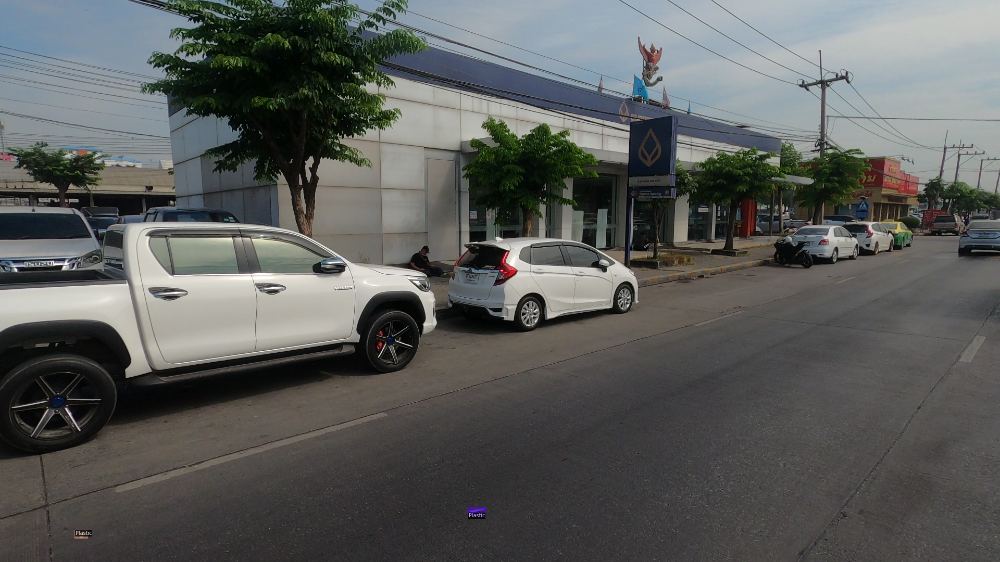

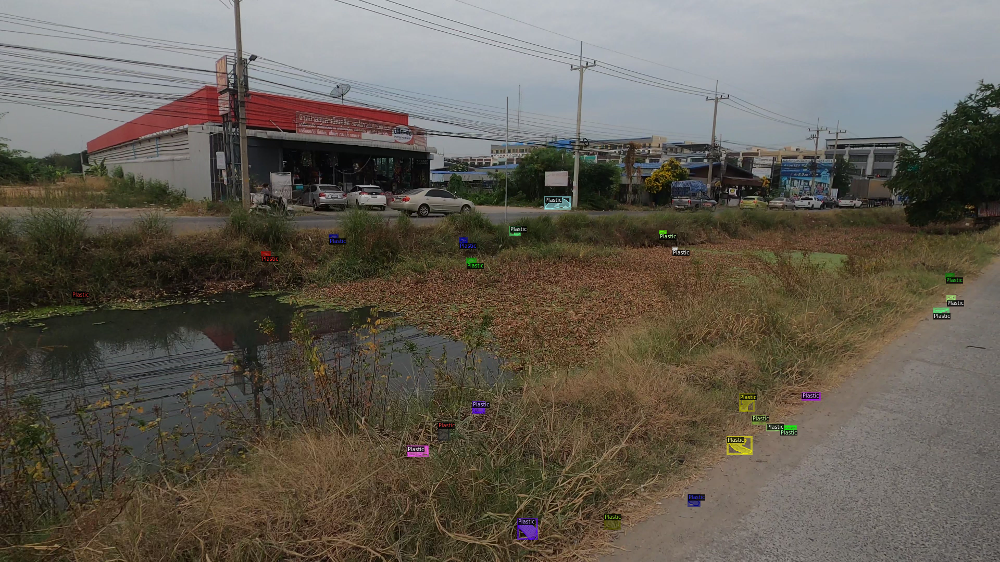

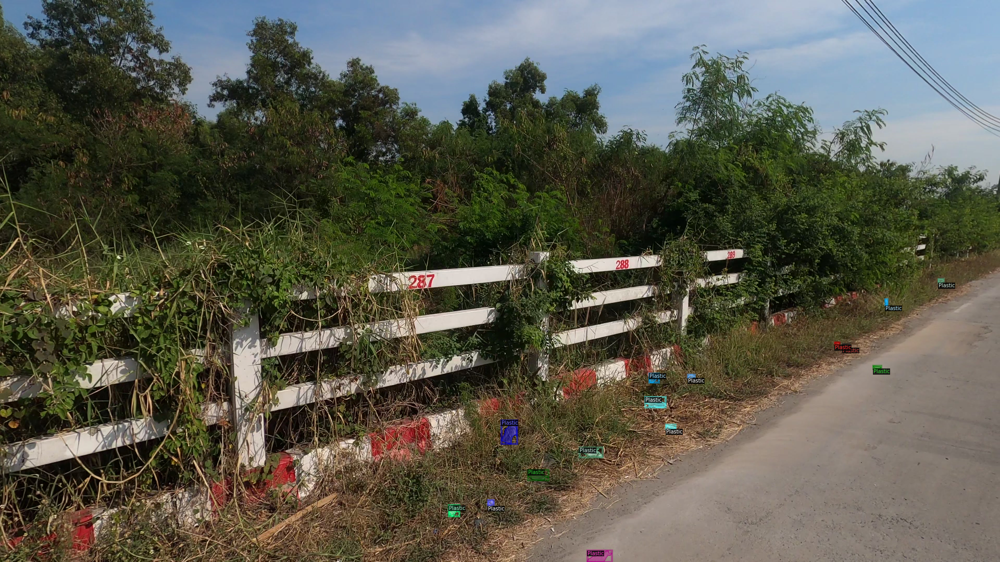

In [3]:
#visualize training data samples
talad_train_1_metadata = MetadataCatalog.get("talad_train_1")
dataset_dicts = DatasetCatalog.get("talad_train_1")

for d in random.sample(dataset_dicts, 3):
    # print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=talad_train_1_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

[03/12 06:40:19 d2.data.datasets.coco]: Loaded 215 images in COCO format from /content/TaladThai/data/val/annotations/annotations_val_1.json
/content/TaladThai/data/val/images/GX014429 235.jpg


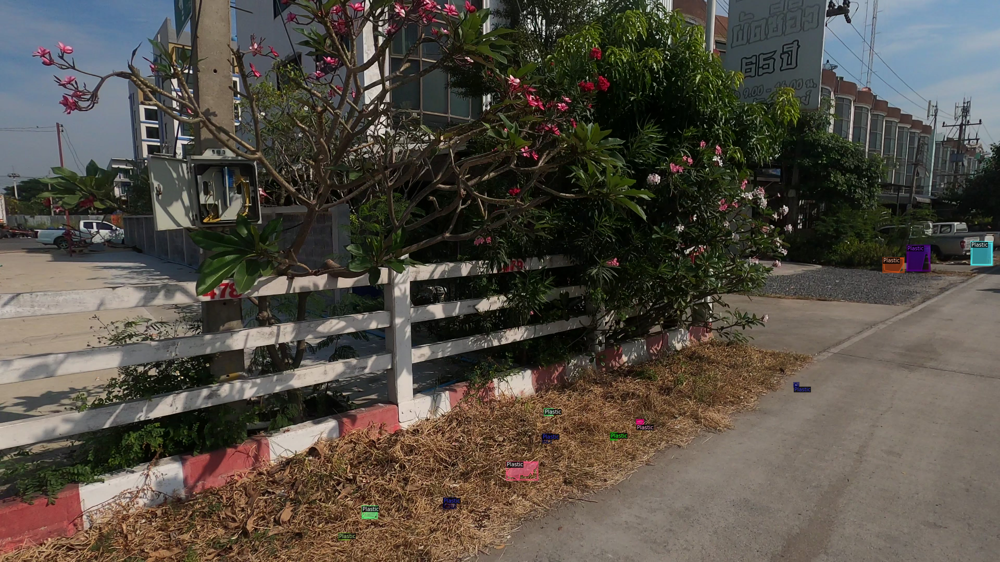

/content/TaladThai/data/val/images/GX014430 307.jpg


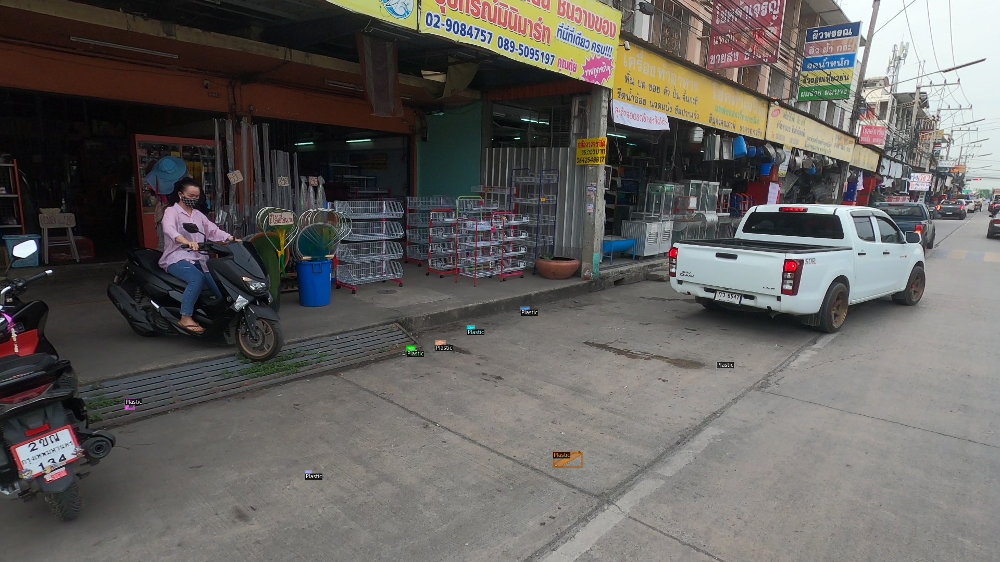

/content/TaladThai/data/val/images/GX014429 222.jpg


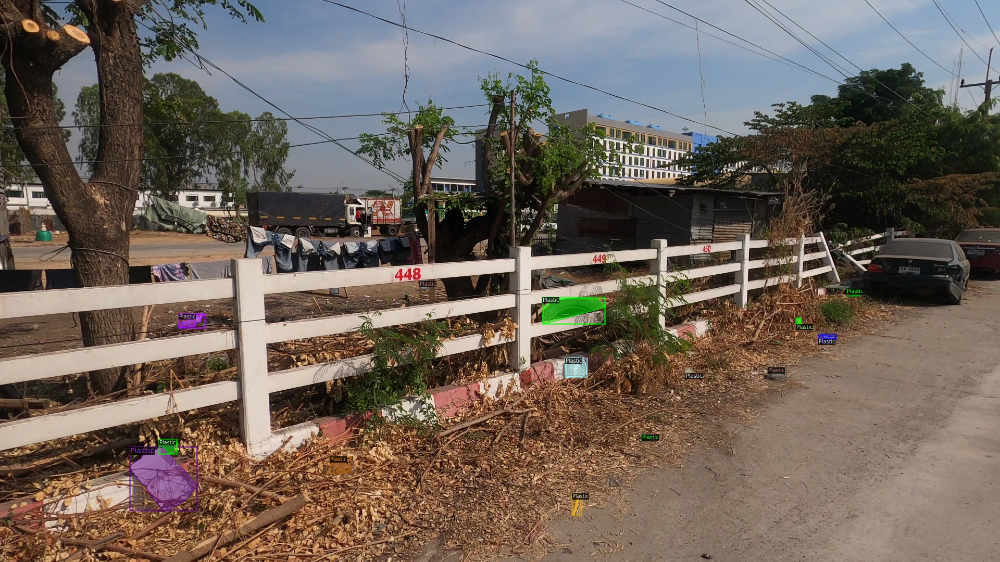

In [4]:
#visualize validation data samples
talad_val_1_metadata = MetadataCatalog.get("talad_val_1")
dataset_dicts = DatasetCatalog.get("talad_val_1")

for d in random.sample(dataset_dicts, 3):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=talad_val_1_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

[03/12 06:40:24 d2.data.datasets.coco]: Loaded 88 images in COCO format from /content/TaladThai/data/test/annotations/annotations_test_1.json
/content/TaladThai/data/test/images/GX014430 120.jpg


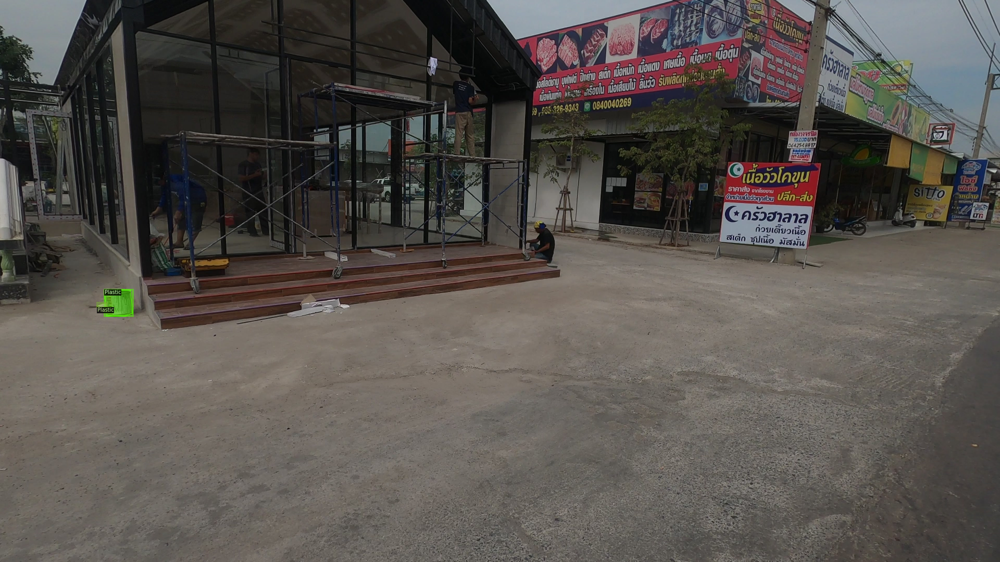

/content/TaladThai/data/test/images/GX054430 186.jpg


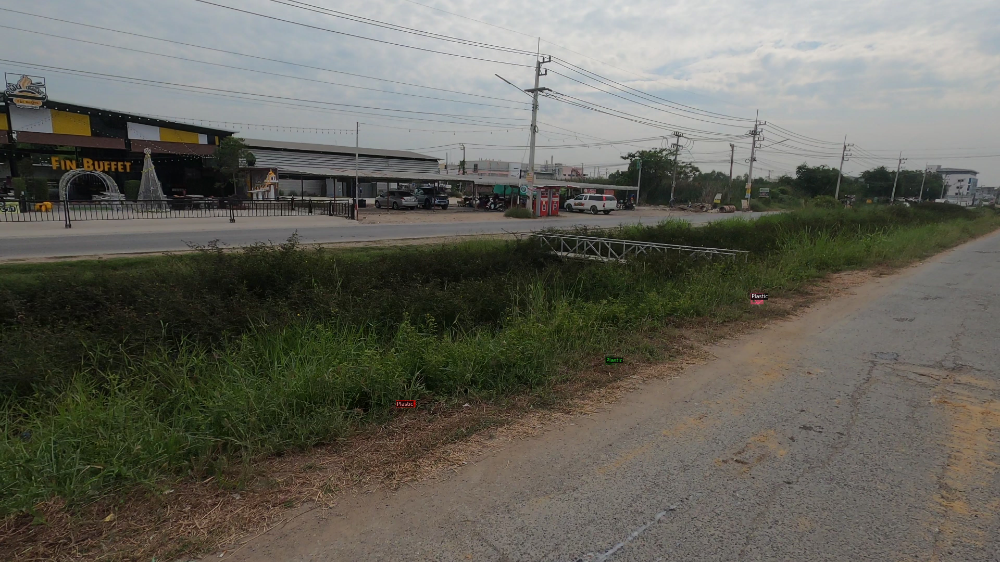

/content/TaladThai/data/test/images/GX034430 051.jpg


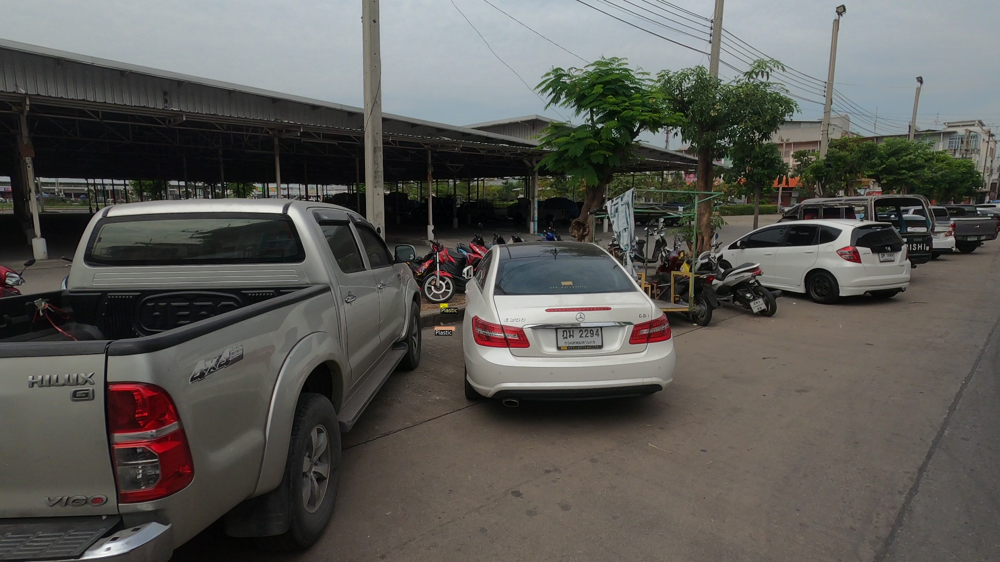

In [5]:
#visualize validation data samples
talad_val_1_metadata = MetadataCatalog.get("talad_test_1")
dataset_dicts = DatasetCatalog.get("talad_test_1")

for d in random.sample(dataset_dicts, 3):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=talad_val_1_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [10]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("talad_train_1",)
cfg.DATASETS.TEST = ("talad_val_1",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.OUTPUT_DIR = "/content/output"
cfg.MODEL.WEIGHTS = "/content/output/model_0029999.pth"# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  
cfg.SOLVER.MAX_ITER = 50000 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1024  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
# trainer.train()

[03/12 06:41:52 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [7]:
cfg.MODEL.WEIGHTS = os.path.join("/content/output/", "model_0029999.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[03/12 06:41:21 d2.data.datasets.coco]: Loaded 88 images in COCO format from /content/TaladThai/data/test/annotations/annotations_test_1.json
/content/TaladThai/data/test/images/GX014430 208.jpg


/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:124: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  filter_inds = filter_mask.nonzero()


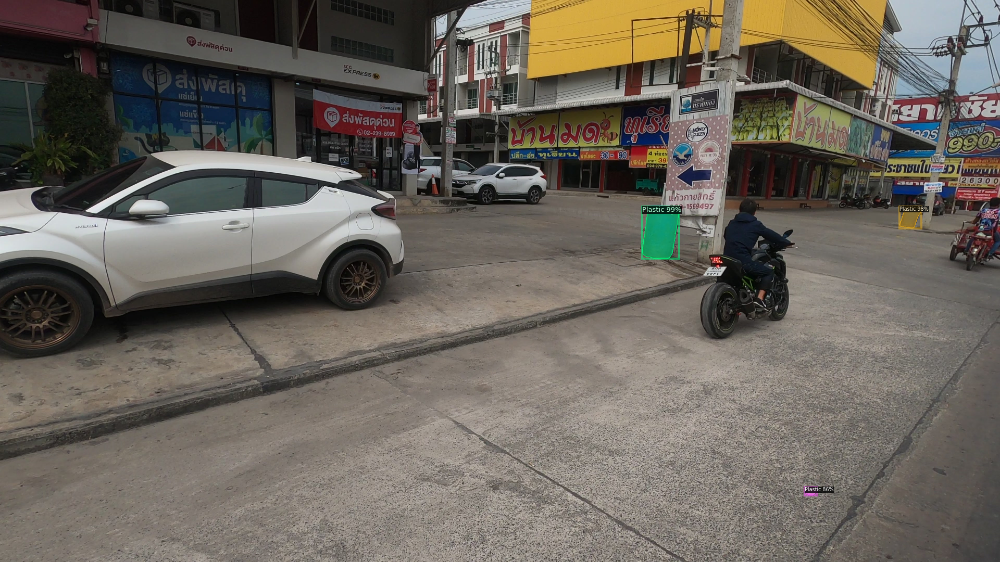

/content/TaladThai/data/test/images/GX044430 307.jpg


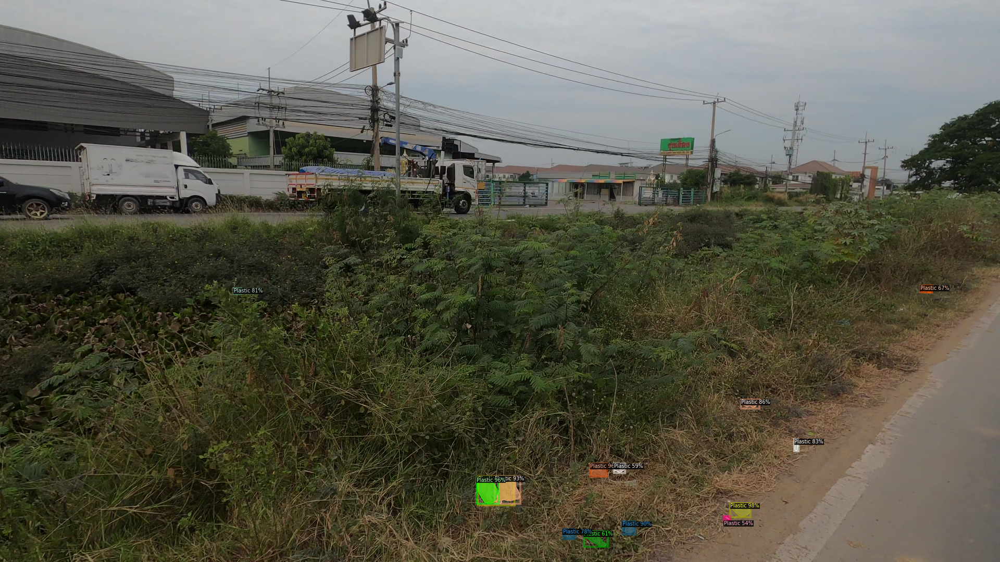

/content/TaladThai/data/test/images/GX014429 259.jpg


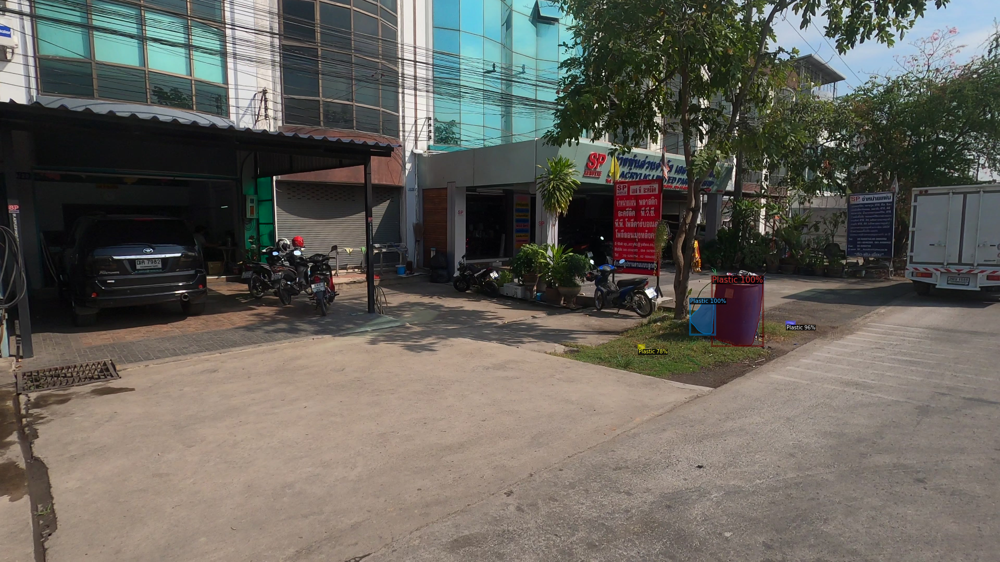

In [8]:
taco_metadata = MetadataCatalog.get("talad_test_1")
dataset_dicts = DatasetCatalog.get("talad_test_1")
for d in random.sample(dataset_dicts, 3):
    print(d["file_name"])
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=taco_metadata, 
                   scale=0.5, 
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [11]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("talad_test_1", cfg, False, output_dir="/content/output")
val_loader = build_detection_test_loader(cfg, "talad_test_1")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [03/12 06:41:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[03/12 06:41:59 d2.data.datasets.coco]: Loaded 88 images in COCO format from /content/TaladThai/data/test/annotations/annotations_test_1.json
[03/12 06:41:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/12 06:41:59 d2.data.common]: Serializing 88 elements to byte tensors and concatenating them all ...
[03/12 06:41:59 d2.data.common]: Serialized dataset takes 0.34 MiB
[03/12 06:41:59 d2.evaluation.evaluator]: Start inference on 88 images
[03/12 06:42:29 d2.evaluation.evaluator]: Inference done 11/88. 0.2338 s / img. ETA=0:03:10
[03/12 06:42:35 d2.evaluation.evaluator]: Inference done 14/88. 0.2232 s / img. ETA=0:02:55
[03/12 06:42:41 d2.evaluation.evaluator]: Inference done 16/88. 0.2314 s / img. ETA=0:02:55
[03/